In [2]:
import rioxarray
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np
from matplotlib import colors
import glob
from land_wavelet import wclass
import cv2
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import cartopy
from pyproj import CRS, Transformer

In [1]:
cd ..

/home/ck/pythonWorkspace/proj_CEH


In [18]:
files = glob.glob('/home/ck/DIR/cornkle/data/EUMDAC_MTG_TESTS/MTG_VIS_tifs/FCI_tif_NRT/*.tif')

In [46]:
with open("/home/ck/DIR/cornkle/data/EUMDAC_MTG_TESTS/domain_tifs/crs_proj_geostationary_MTG.txt", "r") as f:
    crs = CRS.from_proj4(f.read())
def read_geotiff(file):
    data = rioxarray.open_rasterio(file)
    data_rio = data.rio.write_crs(crs)
    data_reprojected = data_rio.rio.reproject("EPSG:4326")
    data_reprojected = data_reprojected.where(data_reprojected.values<60000, other=0)

    data_reprojected = data_reprojected.sel(x=slice(13,36), y=slice(-9, -35))
    
    #data = (data - np.min(data)) / (np.max(data) - np.min(data))*10
    #data = data.where((data>2) & (data<3))
    
    return data_reprojected.squeeze()

In [52]:
da_box = read_geotiff(files[120])

In [53]:
### CODE TO SAVE INITIAL PROJECTION
# # Use rioxarray to interpret CRS
# data_rio = da_tif.rio.write_crs(da['geostationary'].attrs['crs_wkt'])

# # Check the CRS
# print(data_rio.rio.crs)

# # Reproject to WGS84 (EPSG:4326) if necessary
# data_reprojected = data_rio.rio.reproject("EPSG:4326")

# # Save as PROJ String
# with open("/home/ck/DIR/cornkle/data/EUMDAC_MTG_TESTS/domain_tifs/crs_proj_geostationary_MTG.txt", "w") as f:
#     f.write(data_rio.rio.crs.to_proj4())

/home/ck/miniforge3/envs/general/lib/python3.13/site-packages/cartopy/mpl/feature_artist.py:144: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


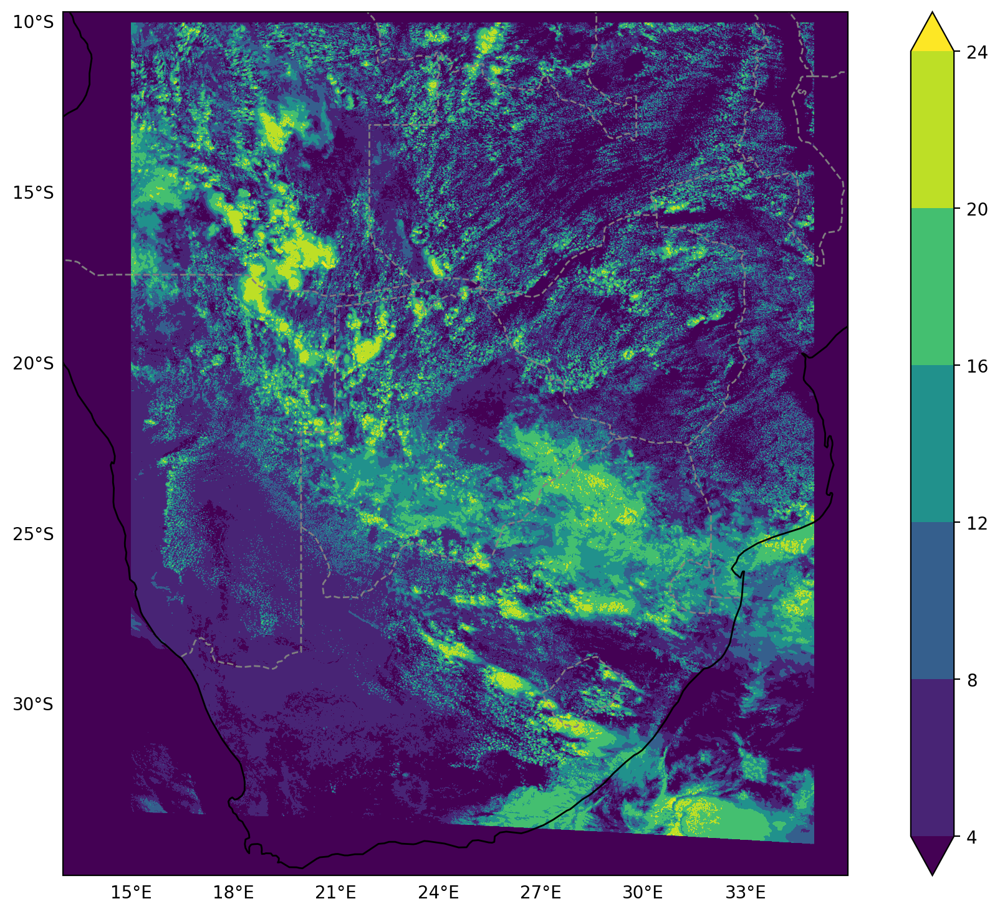

In [54]:
f = plt.figure(figsize=(13,9), dpi=200)
ax = f.add_subplot(111, projection=ccrs.PlateCarree())
plt.contourf(da_box.x.values, da_box.y.values, da_box.where(da_box.values<60000, other=0).squeeze(), transform=ccrs.PlateCarree(), cmap='viridis', extend='both')
ax.coastlines()

xl = ax.gridlines(draw_labels=True);
xl.top_labels = False
xl.right_labels = False
xl.xlines = False
xl.ylines=False
# Countries
ax.add_feature(cartopy.feature.BORDERS, linestyle='--', color='grey');

cbar = plt.colorbar()


In [55]:
### Create a wavelet decomposition object first. In this example, we initialise the SM5k 5km setup. The setups can be defined in land_wavelet.constants
wObj = wclass.landwav('VIS_05')

Initialised wavelet with scales:  [ 1.5         1.78381067  2.12132034  2.52268925  3.          3.56762135
  4.24264069  5.04537849  6.          7.13524269  8.48528137 10.09075698
 12.         14.27048538 16.97056275 20.18151397 24.         28.54097076
 33.9411255 ]


In [56]:
### The next step prepares the SM image for the wavelet routine. NaNs are removed by filling in zeros that can be masked again after wavelet application.
wObj.read_img(da_box.values, np.arange(0,da_box.shape[0],0.5), np.arange(0,da_box.shape[1],0.5))

In [58]:
# We now apply the wavelet scale decomposition to the image as defined in the wObj object. This step saves wavelet coefficients and powers to the object.
# The resulting powers could be used for diverse analyses.

coeffs, power, scales, period = wObj.applyWavelet(normed='stddev', ge_thresh=None, le_thresh=0, fill=0.01)

Wavelet coeffs (none or stddev) and power (none, stddev or scale) normed by: stddev Please note: Choose none if value reconstruction is intended.


Text(0.5, 1.0, '33.941125496954285 km scale wavelet coefficients')

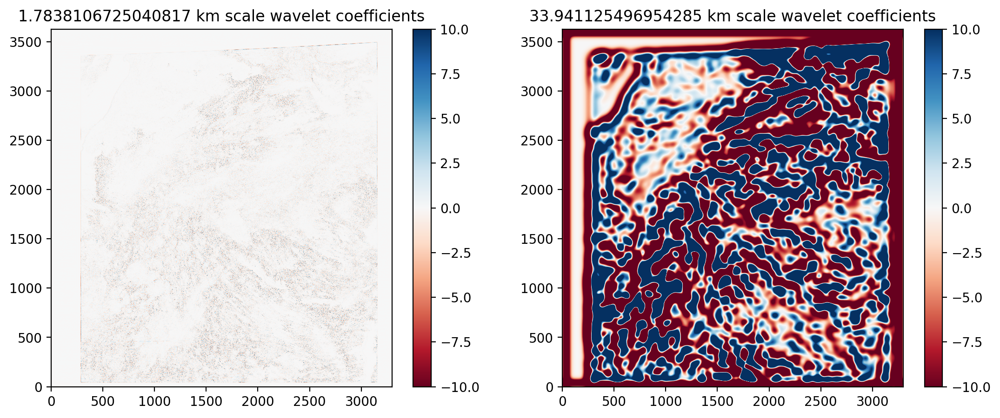

In [59]:
### This shows wavelet coefficient images of two chosen scales

f = plt.figure(figsize=(13,5), dpi=200)

ax = f.add_subplot(121)
scale_id = 1
plt.pcolormesh(wObj.coeffs[scale_id,:,:], vmin=-10,vmax=10, cmap='RdBu')
plt.colorbar()
plt.title(str(wObj.scales[scale_id])+' km scale wavelet coefficients')


ax = f.add_subplot(122)
scale_id = -1

plt.pcolormesh(wObj.coeffs[scale_id,:,:], vmin=-10, vmax=10, cmap='RdBu')
plt.colorbar()
plt.title(str(wObj.scales[scale_id])+' km scale wavelet coefficients')

Text(0.5, 1.0, 'Contours: 2.0 km power on SM')

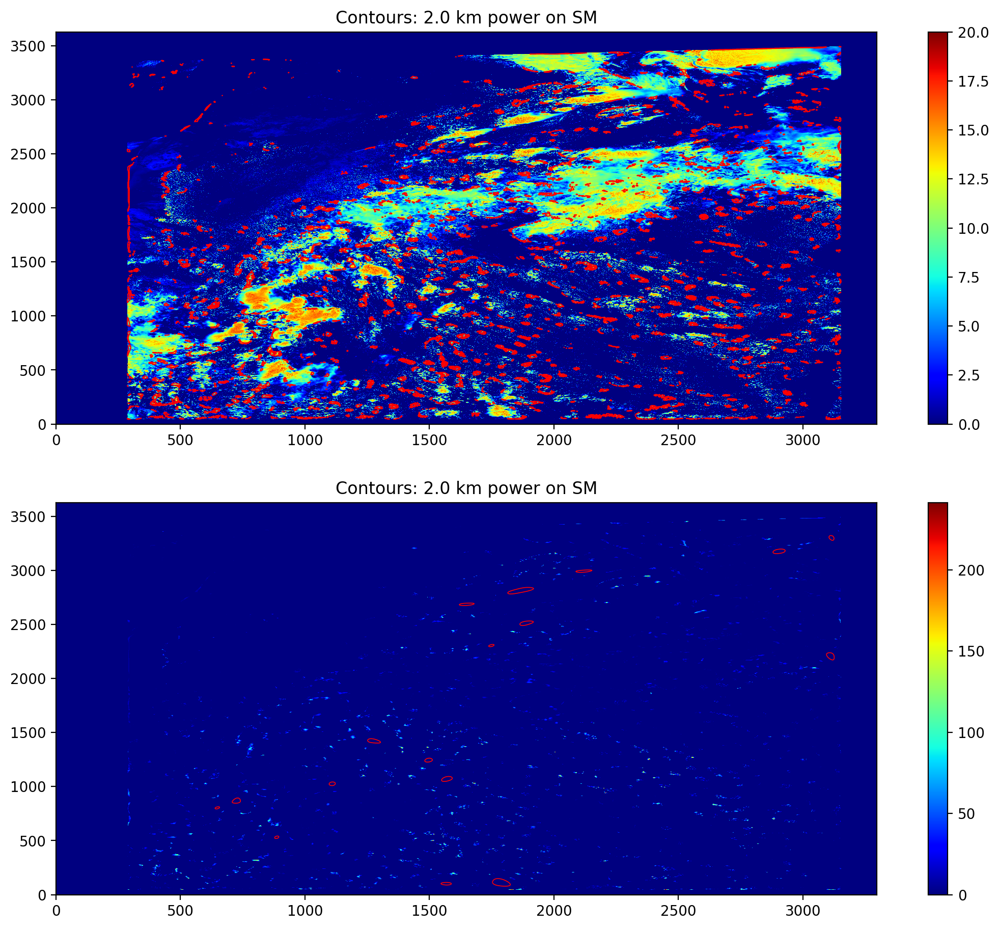

In [61]:
### Same powers as above but as contours plotted onto the SM image. 

f = plt.figure(figsize=(13,11), dpi=200)

ax = f.add_subplot(211)
scale_id = 2
plt.pcolormesh(wObj.image, vmax=20, vmin=0, cmap='jet')
plt.colorbar()
mask = ((np.sum(wObj.power[0:8,:,:],axis=0)<1) | (np.sum(wObj.power[-6::,:,:],axis=0)<0.5)) | (np.abs(wObj.coeffs[-1,:,:]) > 10)
#mask = ((np.sum(wObj.power[0:8,:,:],axis=0)<0.5) | (np.sum(wObj.power[-6::,:,:],axis=0)<0.5)) | (np.abs(wObj.coeffs[-1,:,:]) > 1)
psum = np.sum(wObj.power[:,:,:],axis=0)
psum[mask] = 0
plt.contour(psum, levels=[0,1], colors=['r'], linewidths=0.6)
plt.title('Contours: '+str(np.floor(wObj.scales[scale_id]))+' km power on SM')

ax = f.add_subplot(212)
scale_id = 2
plt.pcolormesh(psum, cmap='jet')
plt.colorbar()

plt.contour(wObj.power[-1,:,:], levels=[-1,10], colors=['r'], linewidths=0.6)
plt.title('Contours: '+str(np.floor(wObj.scales[scale_id]))+' km power on SM')

In [62]:
bools = psum

In [63]:
bools[bools>0]=1
#bools = (bools-1)*-1
bools = bools.astype(np.uint8)

In [64]:
from land_wavelet import line_detection

In [65]:
merged_lines = line_detection.run_line(bools, threshold=5, minLineLength=50, maxLineGap=5)

In [66]:
merged_lines

array([[ 288,  969,  291,  911],
       [ 290, 1798,  294, 1704],
       [ 291, 1680,  291, 1617],
       [ 291, 1137,  294, 1144],
       [ 291, 2116,  294, 2076],
       [ 292,  722,  296,  678],
       [ 772, 1303,  790, 1400],
       [ 861,  703,  870,  643],
       [2520, 3277, 2529, 3224],
       [3145, 2599, 3145, 2540],
       [3094,   48, 3147,   49],
       [1012, 1801, 1070, 1828],
       [2566, 2613, 2616, 2628],
       [3021, 3481, 3089, 3486]], dtype=int32)

In [67]:
#circles = line_detection.run_circle(bools, min_radius=5, max_radius=0)

288 969 291 911
290 1798 294 1704
291 1680 291 1617
291 1137 294 1144
291 2116 294 2076
292 722 296 678
772 1303 790 1400
861 703 870 643
2520 3277 2529 3224
3145 2599 3145 2540
3094 48 3147 49
1012 1801 1070 1828
2566 2613 2616 2628
3021 3481 3089 3486


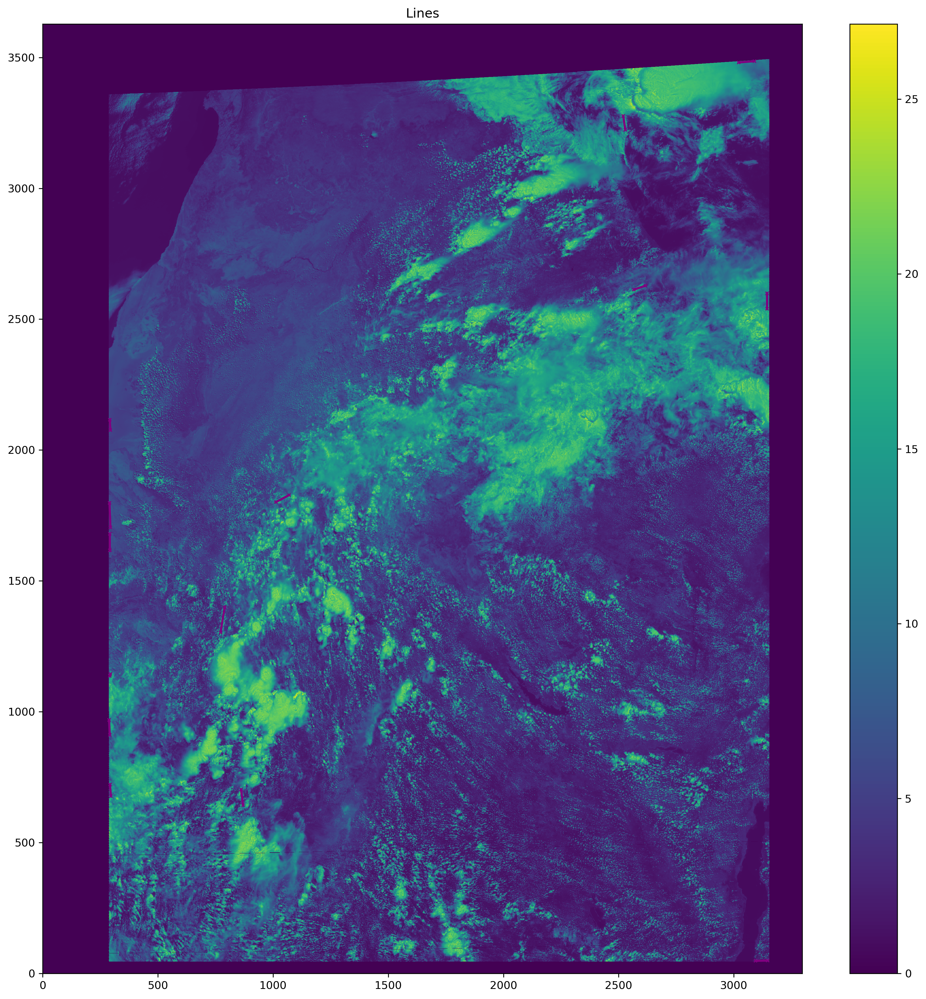

In [71]:
f = plt.figure(figsize=(13,13), dpi=300)

# ax = f.add_subplot(221)

# mp=ax.pcolormesh(bools, cmap='jet')
# plt.colorbar(mp)
# plt.title('Bools')


ax = f.add_subplot(111)

mp= ax.pcolormesh(da_box, cmap='viridis', zorder=0)
plt.colorbar(mp)
plt.title('Lines')

#for line in merged_lines:
for x1, y1, x2, y2 in merged_lines:
    print(x1, y1, x2, y2)
    ax.plot([x1, x2], [y1, y2], marker = 'x', markersize=3, color='purple', linestyle='solid', linewidth=2, zorder=99)
plt.tight_layout()
f.savefig('/home/ck/Desktop/test2.png')